In [0]:
!pip install transformers

In [0]:
!pip install 'matplotlib==3.2.0rc1'

In [0]:
import torch
import transformers
import networkx as nx
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

In [0]:
model = transformers.BertModel.from_pretrained('bert-base-uncased', output_attentions=True)
tokenizer = transformers.BertTokenizer.from_pretrained('bert-base-uncased')

In [0]:
sentence = "maybe I'll regret it, but I hope not"

In [0]:
tks_ids = tokenizer.build_inputs_with_special_tokens(tokenizer.convert_tokens_to_ids(tokenizer.tokenize(sentence)))
tks = tokenizer.convert_ids_to_tokens(tks_ids)

In [0]:
with torch.no_grad():
  _, _, attentions = model(torch.tensor(tks_ids).unsqueeze(0))

In [0]:
attentions = torch.cat(attentions)

In [0]:
def heatplot_attention(i_layer, attentions=attentions, tks=tks):
  fig = plt.figure(figsize=(15, 40))
  axes = []
  for i_head in range(12):
    axes.append(fig.add_subplot(6, 2, 1 + i_head))
    axes[-1].set_title(f"Head {1 + i_layer}:{1 + i_head}")
    sns.heatmap(attentions[i_layer, i_head], 
                vmin=0, vmax=1, 
                yticklabels=tks, xticklabels=tks, 
                annot=True, ax=axes[-1], 
                cbar=False, linewidths=1,
                fmt='04.2f')

In [0]:
def bipartite_attention(i_layer, attentions=attentions, tks=tks):
  fig = plt.figure(figsize=(15,40))
  axes = []
  for i_head in range(12):
    attns = attentions[i_layer, i_head]
    # Matplotlib setup
    axes.append(fig.add_subplot(6, 2, 1 + i_head))
    axes[-1].set_title(f'Head {1 + i_layer}:{1 + i_head}')
    # Graph construction
    G = nx.DiGraph()
    top_node_labels, bottom_node_labels = zip(*tuple((f'{i} {tk}', f'{tk} {i}') 
                                              for i, tk in enumerate(tks)))
    G.add_nodes_from(top_node_labels, bipartite=0)
    G.add_nodes_from(bottom_node_labels, bipartite=1)
    G.add_weighted_edges_from([(tnl, bnl, weight) 
                              for tnl, row in zip(top_node_labels, attns) 
                              for bnl, weight in zip(bottom_node_labels, row)])
    edge_ws = np.array([G[u][v]['weight'] for u,v in G.edges()])
    # Graph plot
    nx.draw_networkx(G,
                    # bipartite layout 
                    pos={
                        **{tnl: (0, -i) for i, tnl in enumerate(top_node_labels)},
                        **{bnl: (1, -i) for i, bnl in enumerate(bottom_node_labels)}, 
                    },
                    # presentation options 
                    width=edge_ws * 3, edge_color=edge_ws, edge_cmap=plt.cm.afmhot_r, style='dotted',
                    edge_vmin=0, edge_vmax=1,
                    min_source_margin=20, min_target_margin=20,  
                    node_size=0, font_size=10, arrowsize=20,
                    ax=axes[-1])

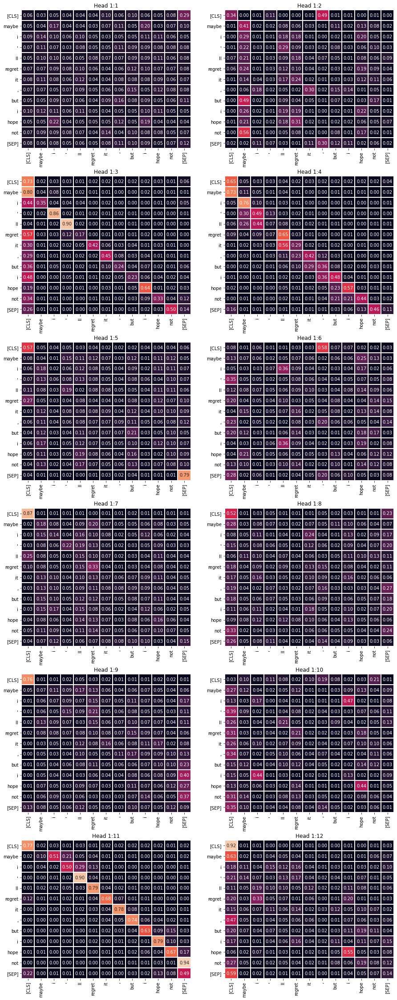

In [0]:
heatplot_attention(0)

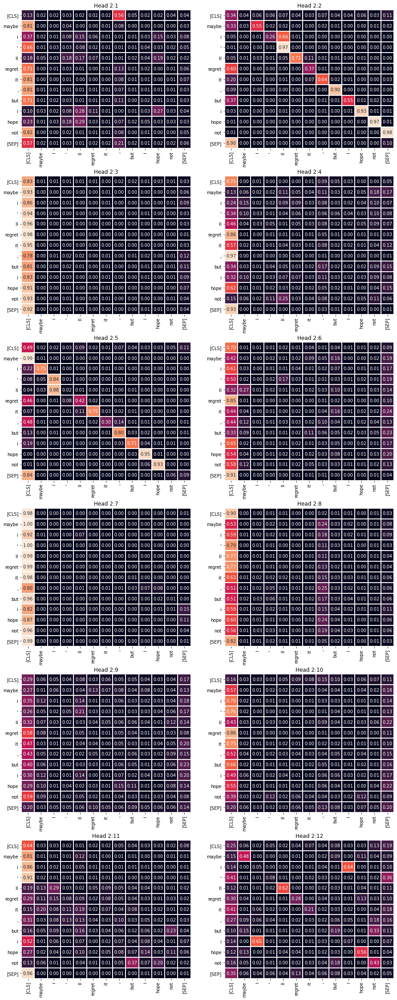

In [0]:
heatplot_attention(1)

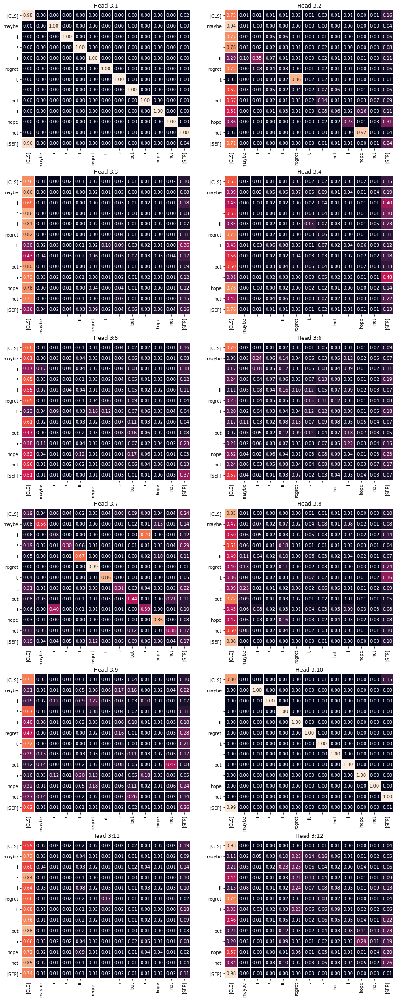

In [0]:
heatplot_attention(2)

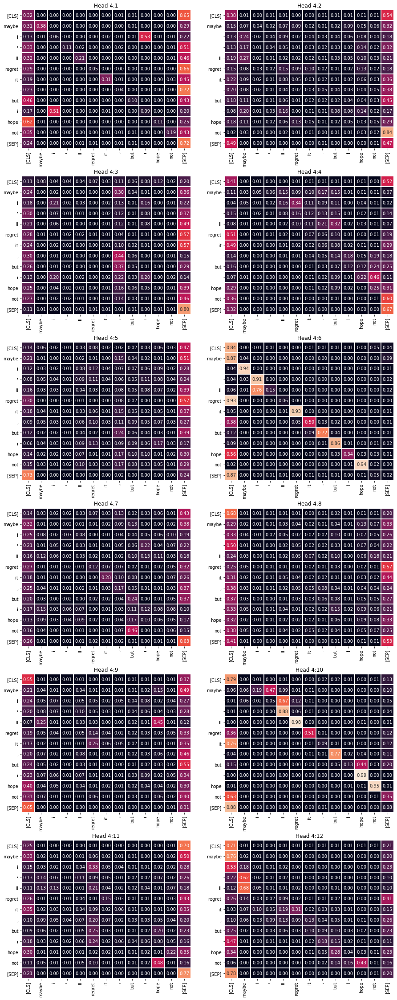

In [0]:
heatplot_attention(3)

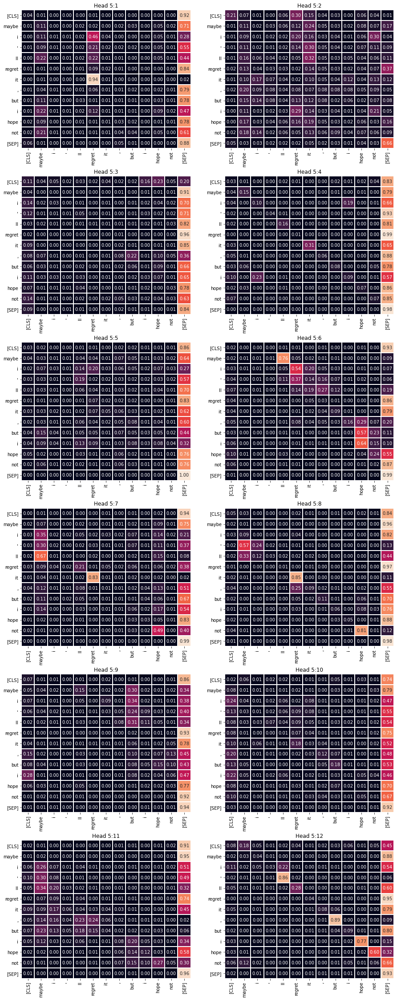

In [0]:
heatplot_attention(4)

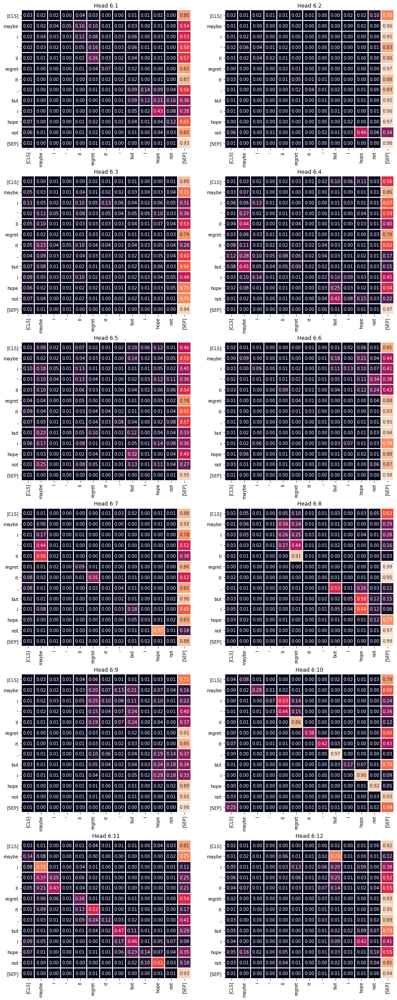

In [0]:
heatplot_attention(5)

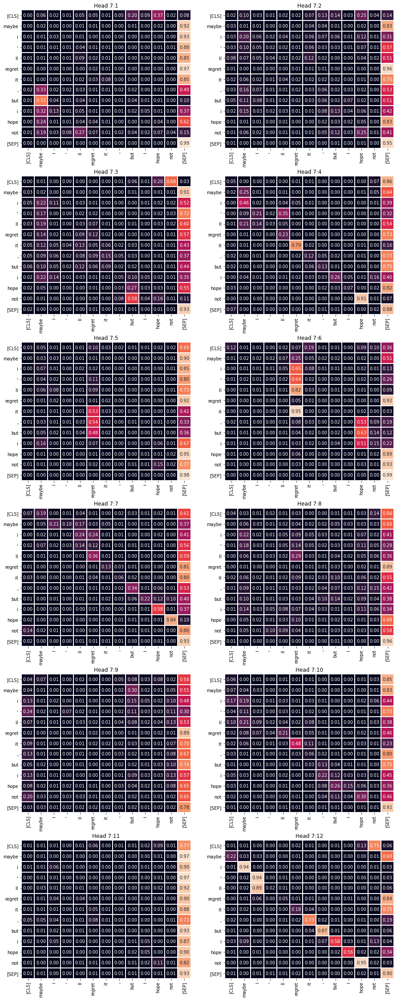

In [0]:
heatplot_attention(6)

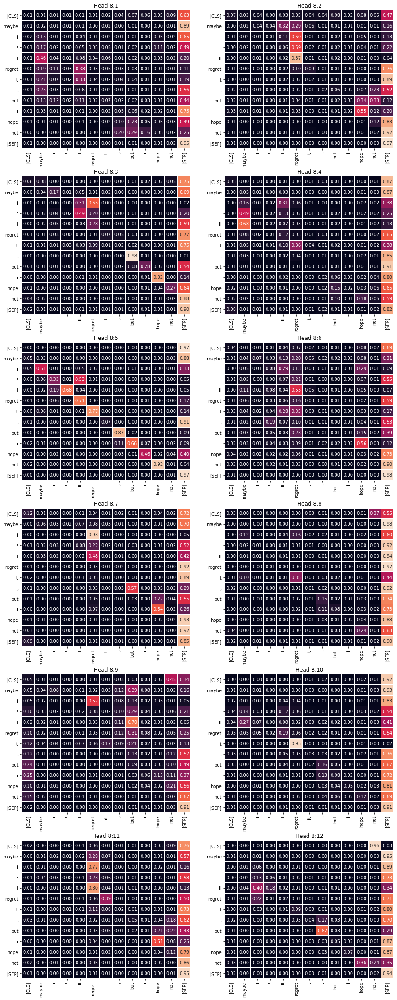

In [0]:
heatplot_attention(7)

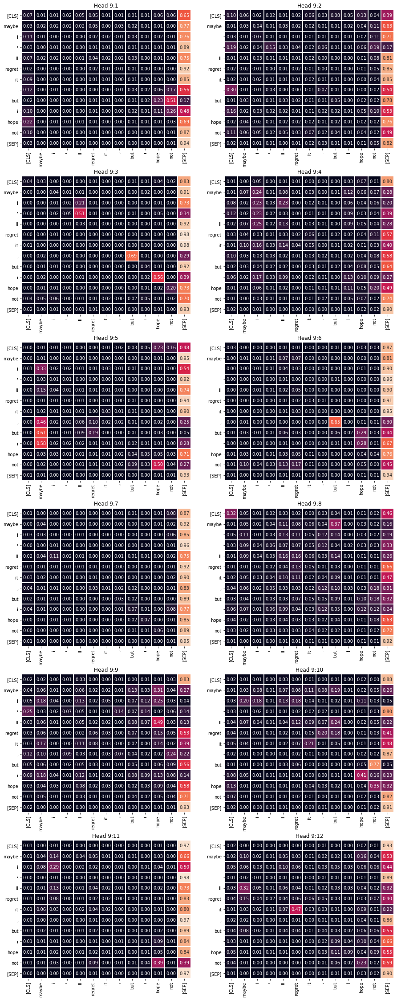

In [0]:
heatplot_attention(8)

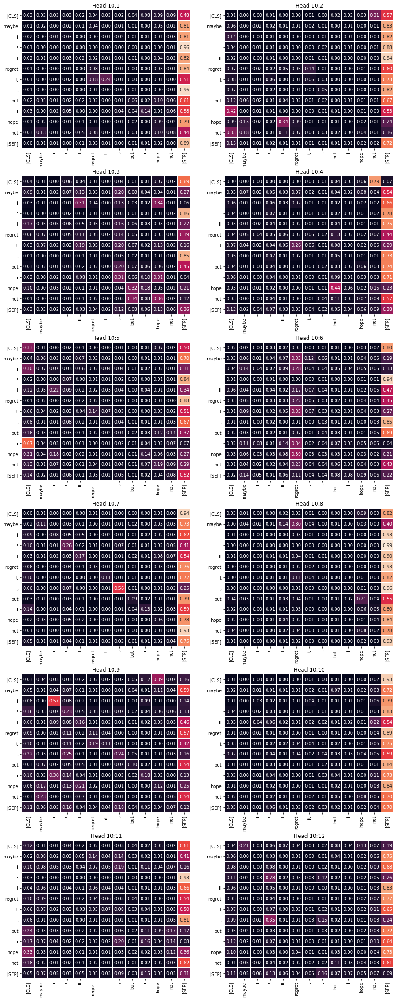

In [0]:
heatplot_attention(9)

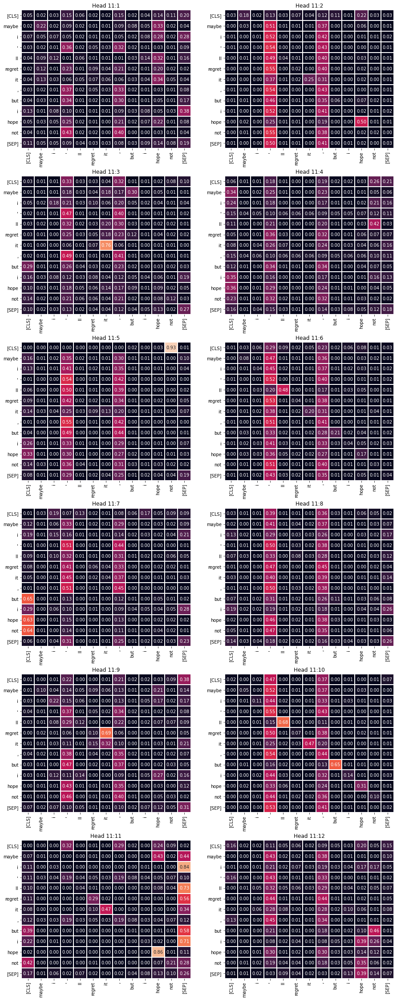

In [0]:
heatplot_attention(10)

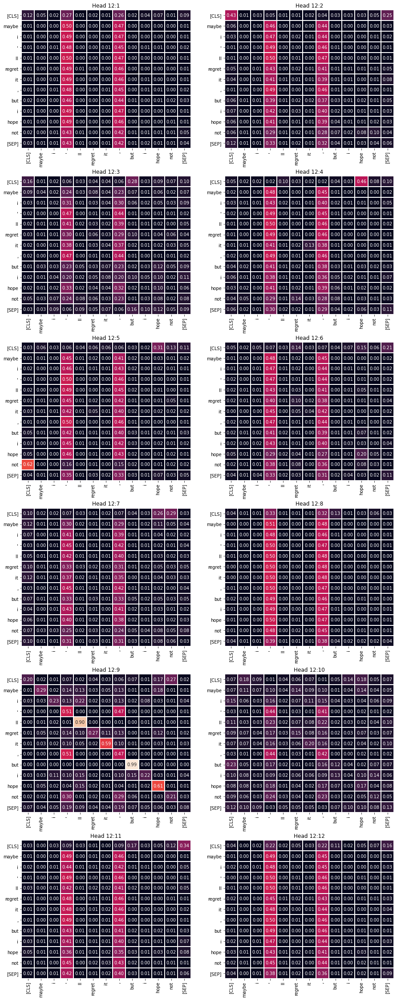

In [0]:
heatplot_attention(11)

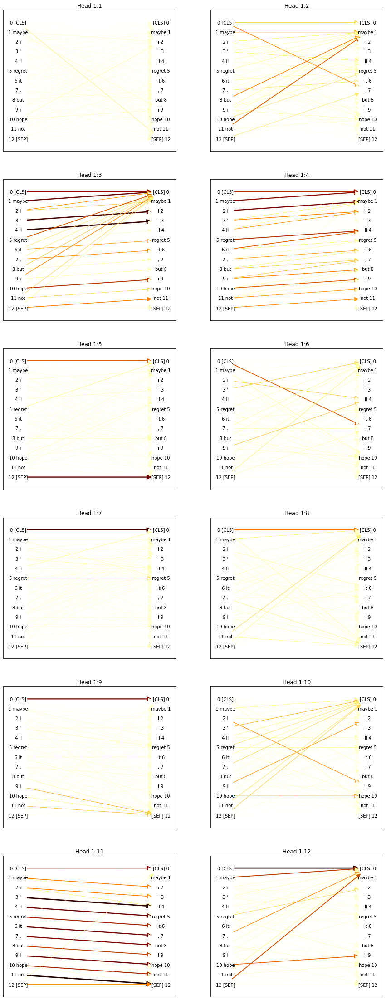

In [0]:
bipartite_attention(0)

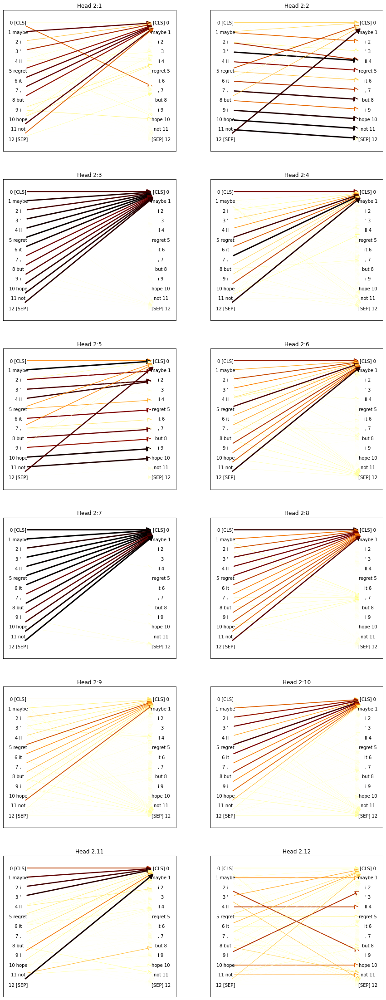

In [0]:
bipartite_attention(1)

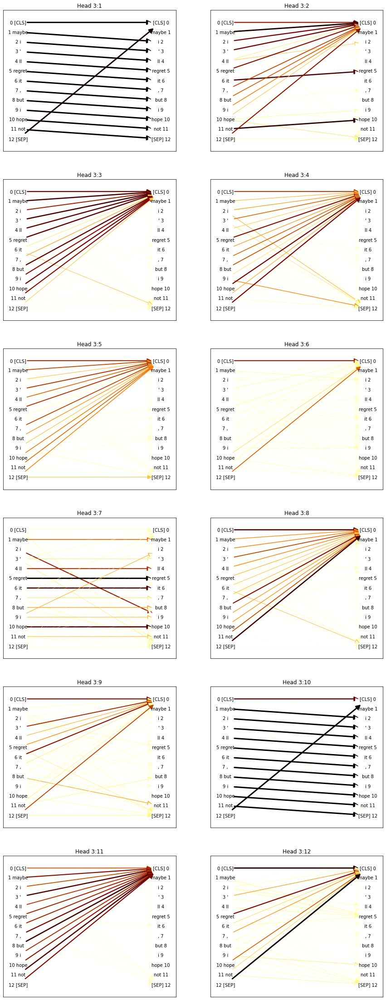

In [0]:
bipartite_attention(2)

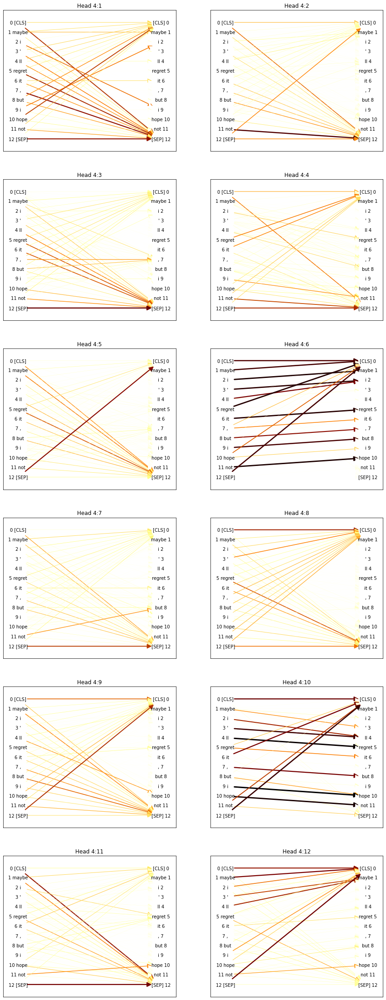

In [0]:
bipartite_attention(3)

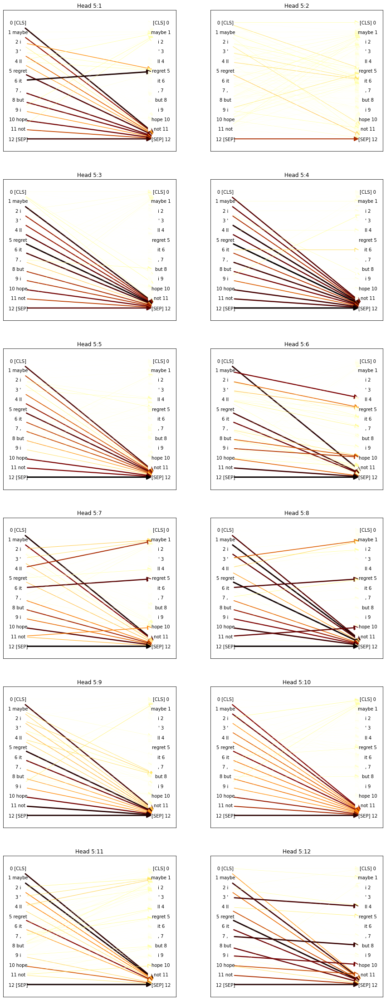

In [0]:
bipartite_attention(4)

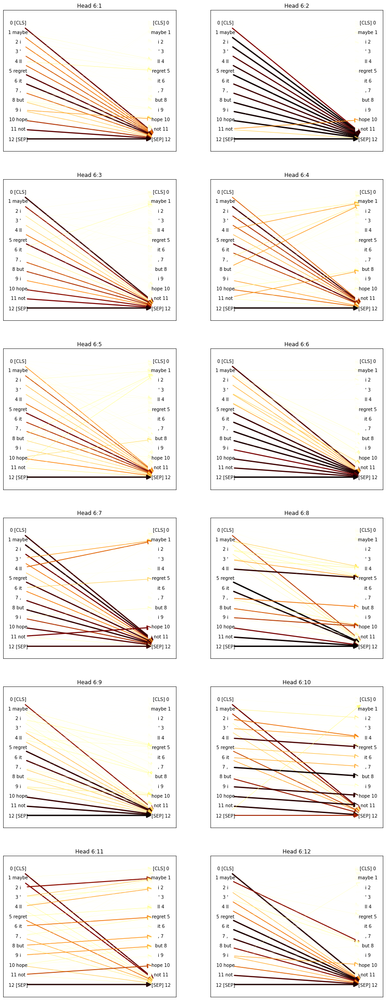

In [0]:
bipartite_attention(5)

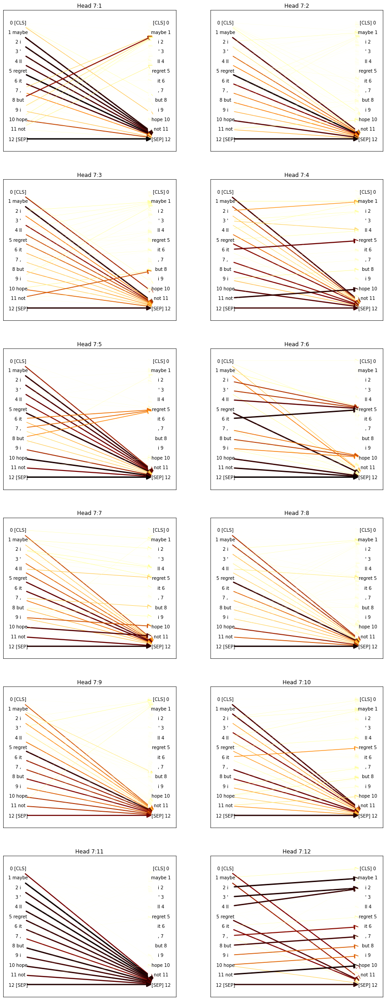

In [0]:
bipartite_attention(6)

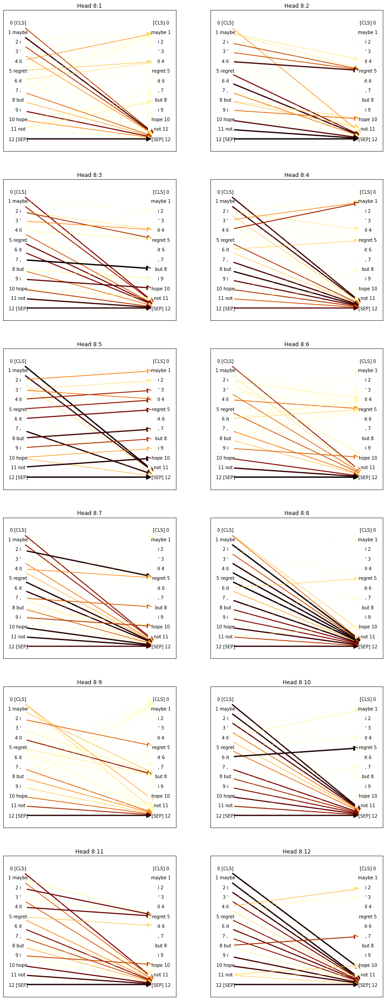

In [0]:
bipartite_attention(7)

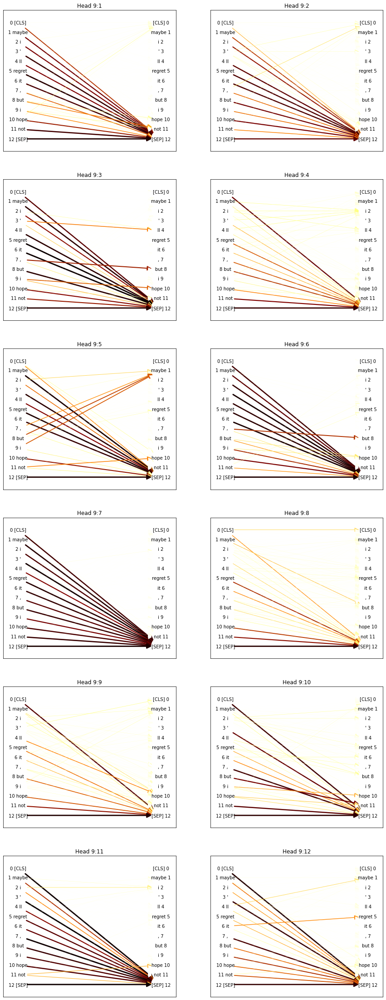

In [0]:
bipartite_attention(8)

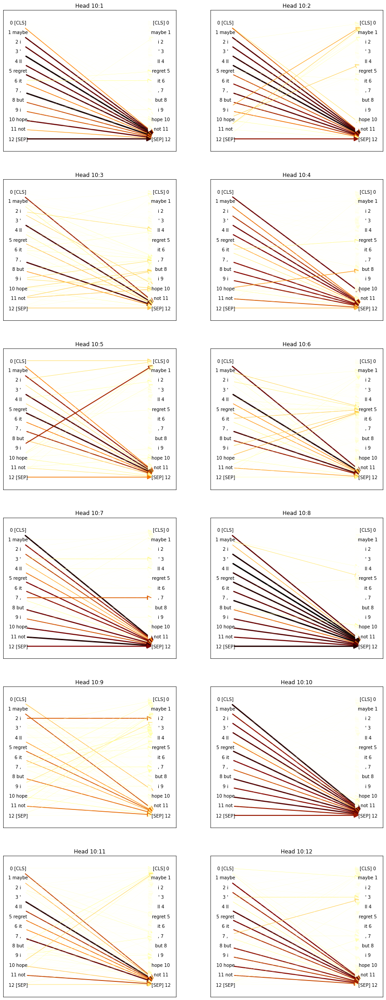

In [0]:
bipartite_attention(9)

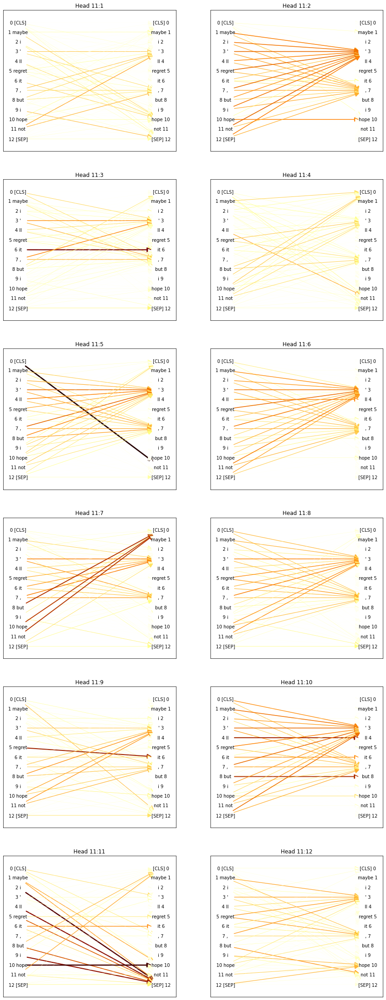

In [0]:
bipartite_attention(10)

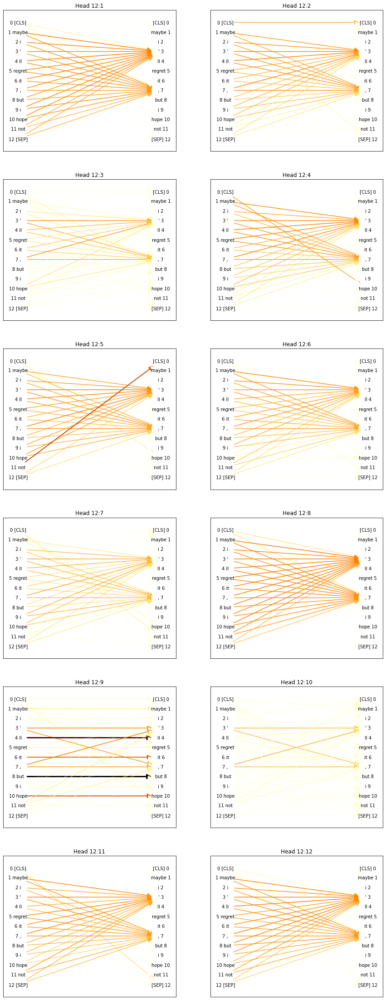

In [0]:
bipartite_attention(11)